In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")

# Problem Statement:

Data Set Information:

This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.


Attribute Information:

For more information, read [Cho et al, 2020].
1. station - used weather station number: 1 to 25
2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98
14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97
15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7
16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6
17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8
18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7
19. lat - Latitude (Â°): 37.456 to 37.645
20. lon - Longitude (Â°): 126.826 to 127.135
21. DEM - Elevation (m): 12.4 to 212.3
22. Slope - Slope (Â°): 0.1 to 5.2
23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9
24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9
25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T

Please note that there are two target variables here: 

1) Next_Tmax: Next day maximum temperature

2) Next_Tmin: Next day  minimum temperature

In [2]:
df=pd.read_csv('tempareture.csv')
df.head(50)

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5
5,6.0,30-06-2013,31.9,23.5,52.437126,85.307251,29.219342,23.822613,6.182295,50.231389,...,0.000000,0.000000,0.000000,37.5102,127.042,54.6384,0.1457,5873.780762,31.5,24.0
6,7.0,30-06-2013,31.4,24.4,56.287189,81.019760,28.551859,24.238467,5.587135,125.110007,...,0.000000,0.000000,0.000000,37.5776,126.838,12.3700,0.0985,5849.233398,30.9,23.4
7,8.0,30-06-2013,32.1,23.6,52.326218,78.004539,28.851982,23.819054,6.104417,42.011547,...,0.000000,0.000000,0.000000,37.4697,126.910,52.5180,1.5629,5863.992188,31.1,22.9
8,9.0,30-06-2013,31.4,22.0,55.338791,80.784607,28.426975,23.332373,6.017135,85.110971,...,0.000000,0.000000,0.000000,37.4967,126.826,50.9312,0.4125,5876.901367,31.3,21.6
9,10.0,30-06-2013,31.6,20.5,56.651203,86.849632,27.576705,22.527018,6.518841,63.006075,...,0.000000,0.000000,0.000000,37.4562,126.955,208.5070,5.1782,5893.608398,30.5,21.0


The Station is in sequence 1-25, and data is in sequence

# Data Preprocessing

In [3]:
df.shape

(7752, 25)

In [4]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

<AxesSubplot:>

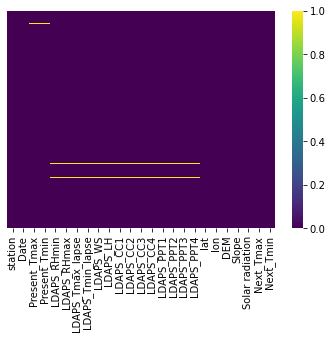

In [5]:
sns.heatmap(df.isnull(),yticklabels=False,cmap='viridis')

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7750 non-null   float64
 1   Date              7750 non-null   object 
 2   Present_Tmax      7682 non-null   float64
 3   Present_Tmin      7682 non-null   float64
 4   LDAPS_RHmin       7677 non-null   float64
 5   LDAPS_RHmax       7677 non-null   float64
 6   LDAPS_Tmax_lapse  7677 non-null   float64
 7   LDAPS_Tmin_lapse  7677 non-null   float64
 8   LDAPS_WS          7677 non-null   float64
 9   LDAPS_LH          7677 non-null   float64
 10  LDAPS_CC1         7677 non-null   float64
 11  LDAPS_CC2         7677 non-null   float64
 12  LDAPS_CC3         7677 non-null   float64
 13  LDAPS_CC4         7677 non-null   float64
 14  LDAPS_PPT1        7677 non-null   float64
 15  LDAPS_PPT2        7677 non-null   float64
 16  LDAPS_PPT3        7677 non-null   float64


In [7]:
df.iloc[7745:7755,:]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7745,21.0,30-08-2017,23.1,17.8,24.688997,78.261383,27.812697,18.303014,6.603253,9.614074,...,0.000000,0.000000,0.000000,37.5507,127.040,26.2980,0.572100,4456.024414,27.6,17.7
7746,22.0,30-08-2017,22.5,17.4,30.094858,83.690018,26.704905,17.814038,5.768083,82.146707,...,0.000000,0.000000,0.000000,37.5102,127.086,21.9668,0.133200,4441.803711,28.0,17.1
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.6450,127.135,212.3350,5.178230,5992.895996,38.9,29.8


The staion will be 1.0 and 2.0, date will be 31-08-2017

In [8]:
# checking the null values of station
df[df['station'].isnull()]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.370,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.6450,127.135,212.335,5.178230,5992.895996,38.9,29.8


In [9]:
df['station'].iloc[7750]=1.0
df['station'].iloc[7751]=2.0

In [10]:
df['Date'].iloc[7750]='31-08-2017'
df['Date'].iloc[7751]='31-08-2017'

In [11]:
# replacing the null values with the median 
for col in df.columns:
    if col not in ['station','Date']:
        df[col]=df[col].replace(np.nan,df[col].median())

In [12]:
#extracing the month
df['month']=pd.DatetimeIndex(df['Date']).month

In [13]:
#extracing the day
df['day']=pd.DatetimeIndex(df['Date']).day

In [14]:
#extracing the year
df['year']=pd.DatetimeIndex(df['Date']).year

In [15]:
#function for encoding month name
def change_month(col):
    if col==1:
        return 'Jan'
    elif col==2:
        return 'Feb'
    elif col==3:
        return 'Mar'
    elif col==4:
        return 'Apr'
    elif col==5:
        return 'May'
    elif col==6:
        return 'Jun'
    elif col==7:
        return 'Jul'
    elif col==8:
        return 'Aug'
    elif col==9:
        return 'Sep'
    elif col==10:
        return 'Oct'
    elif col==11:
        return 'Nov'
    else:
        return 'Dec'
    

df['month']=df['month'].apply(change_month)

In [16]:
# checking the null values of station
df2=df[df['LDAPS_RHmin'].isnull()]

In [17]:
df2.head(25)

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin,month,day,year


In [18]:
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
month               0
day                 0
year                0
dtype: int64

# EDA

In [19]:
cols=['Present_Tmax','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_PPT1','lat','lon','DEM']

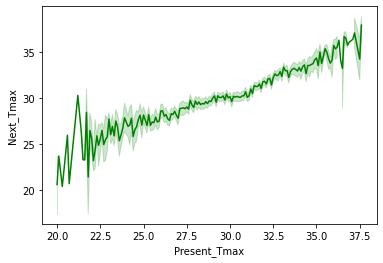

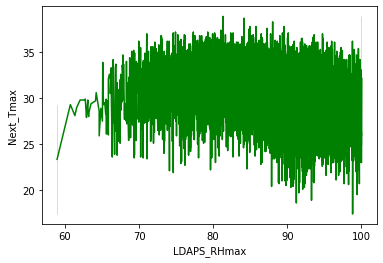

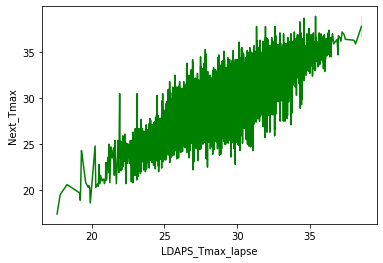

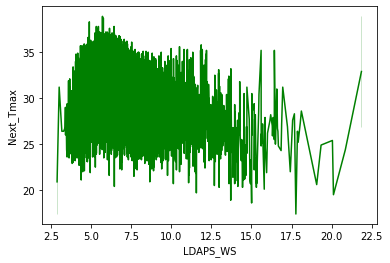

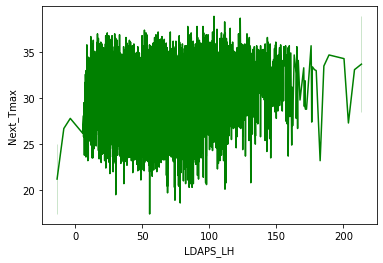

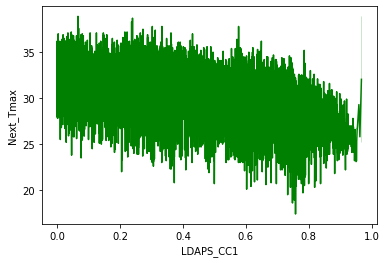

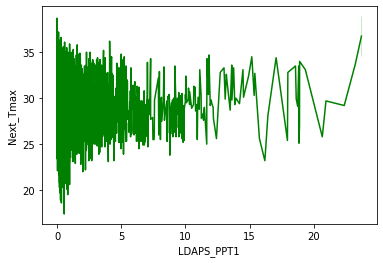

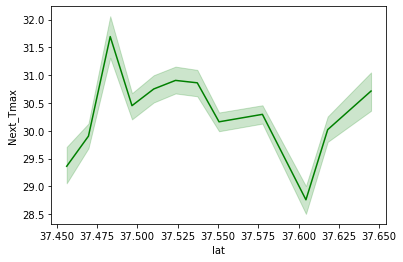

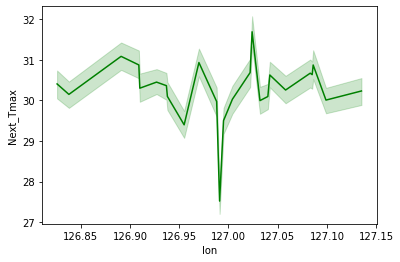

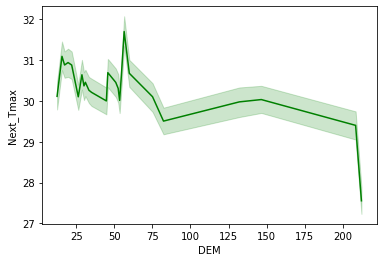

In [20]:
for i in cols:
    sns.lineplot(x=i,y='Next_Tmax',data=df,color='g')
    plt.show()

(i) Present_Tmax is highly correlated with Next_Tmax

(ii) RHmax remains in range of 65-100 for most of the time

(iii) Tmax_lapse is highly positively correlated with Next_Tmax 

(iv) Dem is little negatively correlated with Next_Tmax

In [21]:
cols2=['Present_Tmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_PPT1','lat','lon','DEM']

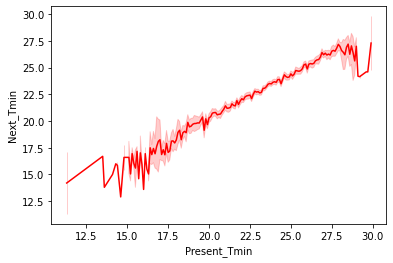

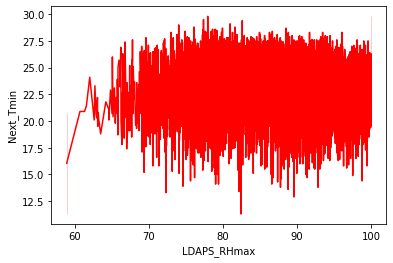

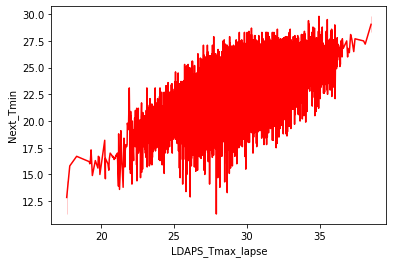

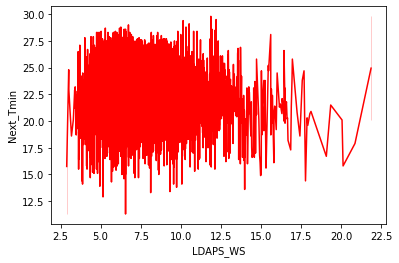

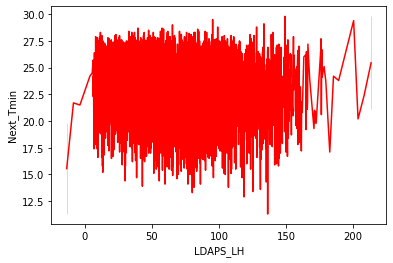

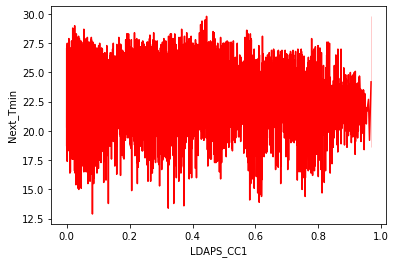

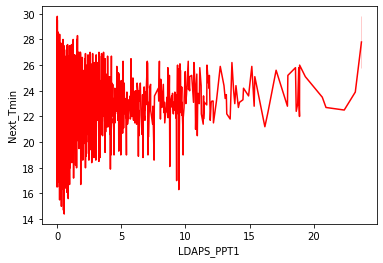

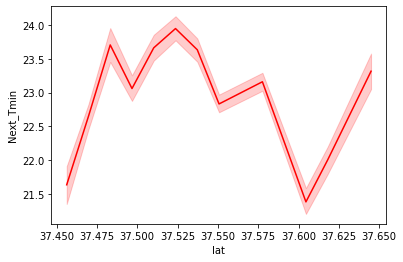

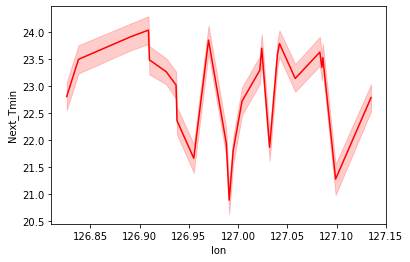

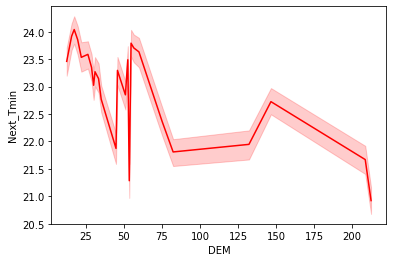

In [22]:
for i in cols2:
    sns.lineplot(x=i,y='Next_Tmin',data=df,color='r')
    plt.show()

(i) Present_Tmin is highly correlated with Next_Tmin

(ii) RHmax remains in range of 65-100 for most of the time

(iii) Tmax_lapse is highly positively correlated with Next_Tmin

(iv) Dem is little negatively correlated with Next_Tmin

<AxesSubplot:xlabel='month', ylabel='Next_Tmin'>

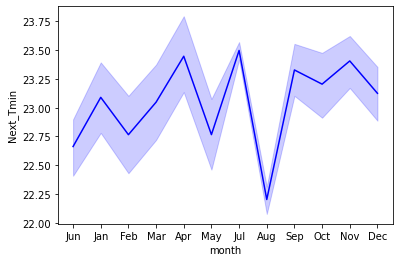

In [23]:
sns.lineplot(x='month',y='Next_Tmin',data=df,color='b')
    

In Jul the Next_Tmin went on peak and in the month of Aug 

<AxesSubplot:xlabel='month', ylabel='Present_Tmin'>

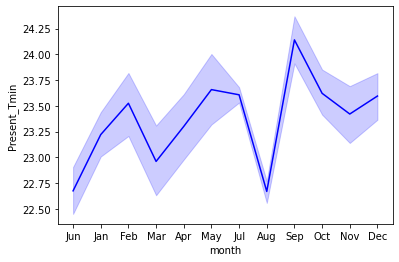

In [29]:
sns.lineplot(x='month',y='Present_Tmin',data=df,color='b')


<AxesSubplot:xlabel='month', ylabel='Next_Tmax'>

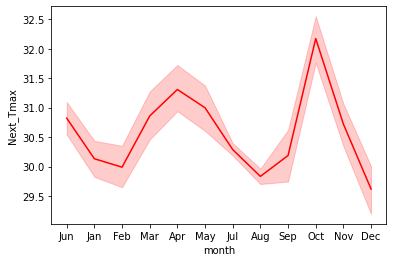

In [24]:
sns.lineplot(x='month',y='Next_Tmax',data=df,color='r')
    

Next_Tmax has been at peak in Oct and minimum in the month of Aug

<AxesSubplot:xlabel='month', ylabel='Present_Tmax'>

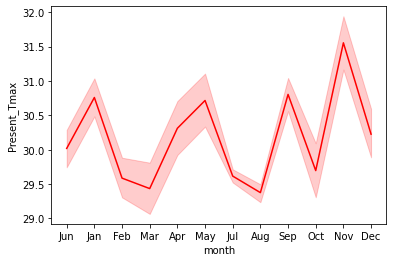

In [30]:
sns.lineplot(x='month',y='Present_Tmax',data=df,color='r')
    

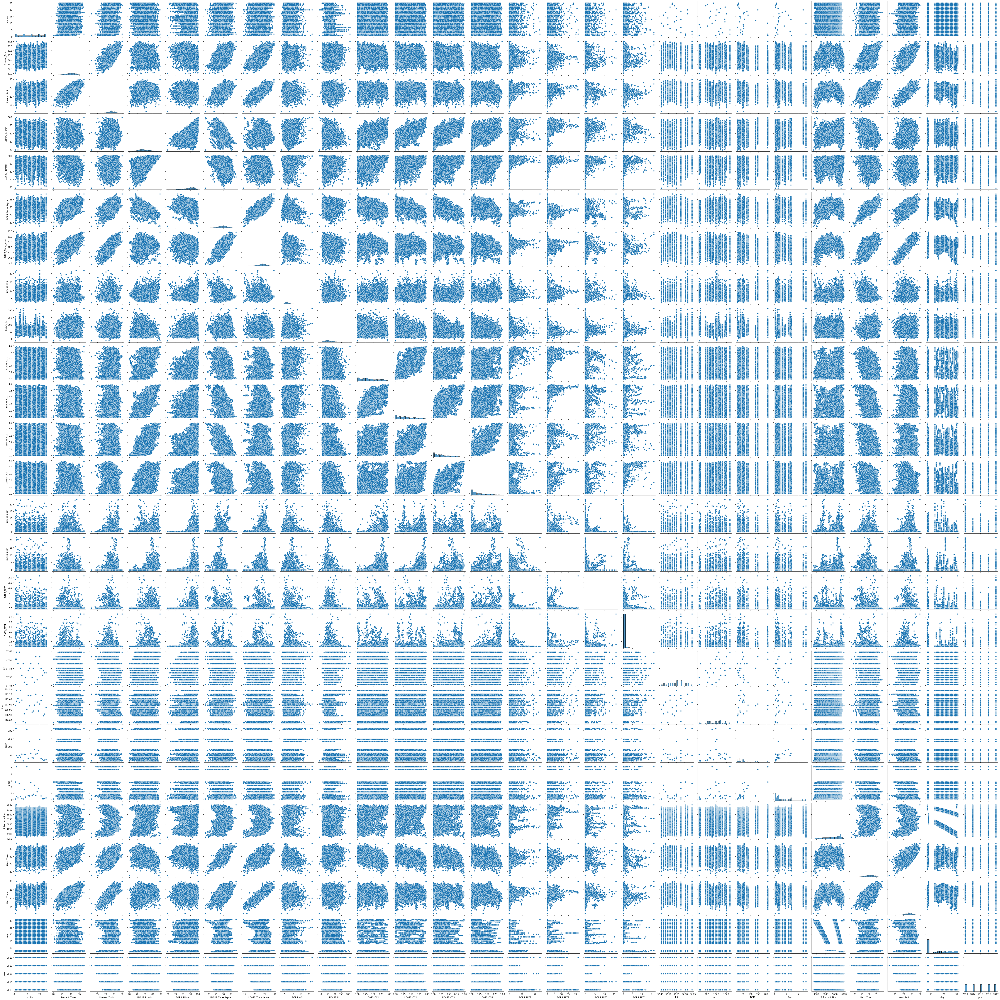

In [31]:
sns.pairplot(df)

<AxesSubplot:xlabel='LDAPS_Tmin_lapse', ylabel='Present_Tmin'>

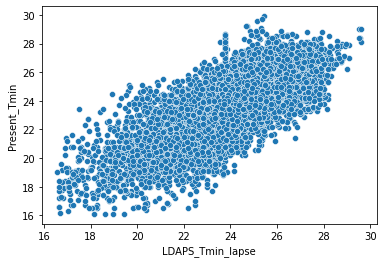

In [112]:
sns.scatterplot(x='LDAPS_Tmin_lapse',y='Present_Tmin',data=df)

In [ ]:
Tmin Lapse is highly correlated tin

<AxesSubplot:xlabel='LDAPS_CC1', ylabel='LDAPS_RHmin'>

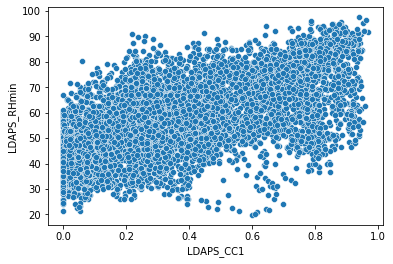

In [109]:
sns.scatterplot(x='LDAPS_CC1',y="LDAPS_RHmin",data=df)

THe RHmin is increased along with CC1, so is for CC2,CC3,CC4

In [25]:
import plotly.express as px
import plotly.graph_objects as gg
import plotly.figure_factory as ff

In [26]:
#pip install plotly

In [27]:
fig = px.density_mapbox(df, lat='lat', lon='lon', z='Present_Tmin',  hover_data=['LDAPS_RHmin', 'LDAPS_RHmax'],                        
                        mapbox_style="stamen-terrain", template = 'plotly_dark', title = 'Minimum Temperature on Lat Long')

fig.show()

In [28]:
fig = px.density_mapbox(df, lat='lat', lon='lon', z='Present_Tmax',  hover_data=['LDAPS_RHmin', 'LDAPS_RHmax'],                        
                        mapbox_style="stamen-terrain", template = 'plotly_dark', title = 'Maximum Temperature on Lat Long')

fig.show()

# Removing of Outliers

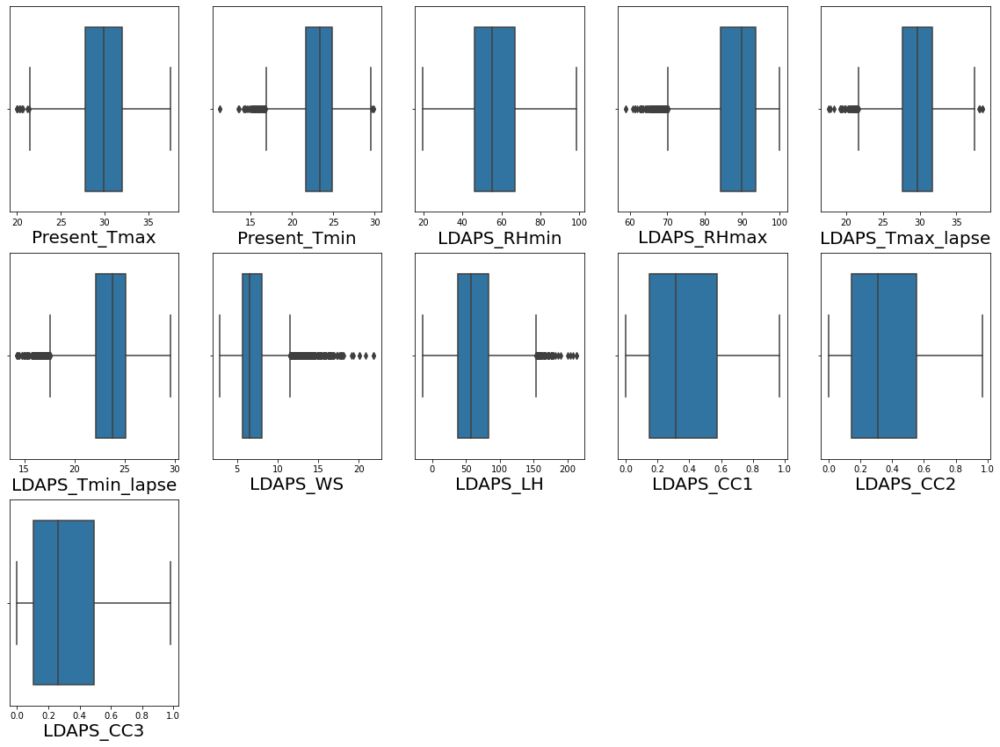

In [33]:
plt.figure(figsize=(20,25),facecolor='white')
plotnum=1
for col in df.drop(columns=['Next_Tmin','Next_Tmax','Date','year','month','day','Slope','DEM','lon','lat','Slope','station'],axis=1):
    if plotnum <= 11:
        plt.subplot(5,5,plotnum)
        sns.boxplot(df[col])
        plt.xlabel(col,fontsize=20)
    plotnum+=1
plt.show()


Outliers exist

In [34]:
# saving the 
features=df[['Present_Tmax','Present_Tmin','LDAPS_RHmin','LDAPS_RHmax','LDAPS_Tmax_lapse','LDAPS_Tmin_lapse','LDAPS_WS'
            ,'LDAPS_LH','LDAPS_CC1','LDAPS_CC2','LDAPS_CC3']]

In [35]:
from scipy.stats import zscore
z=np.abs(zscore(features))

In [36]:
df.shape

(7752, 28)

In [37]:
df=df[(z<3).all(axis=1)]

In [38]:
df.shape

(7483, 28)

In [40]:
loss=(7752-7483)*100/7752
loss

3.4700722394220844

3% data loss is acceptable

# Skewness

In [42]:
df.drop(columns=['Next_Tmin','Next_Tmax','Date','year','month','day','Slope','DEM','lon','lat','Slope','station'],axis=1).skew()

Present_Tmax       -0.227490
Present_Tmin       -0.217935
LDAPS_RHmin         0.284346
LDAPS_RHmax        -0.755434
LDAPS_Tmax_lapse   -0.096644
LDAPS_Tmin_lapse   -0.381931
LDAPS_WS            1.028177
LDAPS_LH            0.599506
LDAPS_CC1           0.487257
LDAPS_CC2           0.473759
LDAPS_CC3           0.644503
LDAPS_CC4           0.680612
LDAPS_PPT1          5.277403
LDAPS_PPT2          5.729713
LDAPS_PPT3          6.705847
LDAPS_PPT4          6.819695
Solar radiation    -0.501098
dtype: float64

Few of the features are skewed

# Normalizing and Removing the skewness

In [45]:
from sklearn.preprocessing import PowerTransformer
powtrans= PowerTransformer(method='yeo-johnson', standardize=True)

In [48]:
cols_skewd= ['LDAPS_PPT3','LDAPS_RHmax','LDAPS_WS','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT4']
df_skewd = df[['LDAPS_PPT3','LDAPS_RHmax','LDAPS_WS','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT4']]

In [47]:
transformed=powtrans.fit_transform(df_skewd)

In [50]:
transformed=pd.DataFrame(transformed,columns=df_skewd.columns)

In [52]:
transformed.skew()

LDAPS_PPT3     1.843692
LDAPS_RHmax   -0.111245
LDAPS_WS       0.009806
LDAPS_CC3      0.087691
LDAPS_CC4      0.128634
LDAPS_PPT1     1.493543
LDAPS_PPT2     1.670818
LDAPS_PPT4     2.110542
dtype: float64

In [53]:
transformed.index=df.index

In [57]:
df[cols_skewd]=transformed[cols_skewd]

In [58]:
df.skew()

station             0.004649
Present_Tmax       -0.227490
Present_Tmin       -0.217935
LDAPS_RHmin         0.284346
LDAPS_RHmax        -0.111245
LDAPS_Tmax_lapse   -0.096644
LDAPS_Tmin_lapse   -0.381931
LDAPS_WS            0.009806
LDAPS_LH            0.599506
LDAPS_CC1           0.487257
LDAPS_CC2           0.473759
LDAPS_CC3           0.087691
LDAPS_CC4           0.128634
LDAPS_PPT1          1.493543
LDAPS_PPT2          1.670818
LDAPS_PPT3          1.843692
LDAPS_PPT4          2.110542
lat                 0.104304
lon                -0.286980
DEM                 1.775148
Slope               1.600877
Solar radiation    -0.501098
Next_Tmax          -0.268366
Next_Tmin          -0.270784
day                 0.262120
year                0.011210
dtype: float64

The skew ness of LDAPS_LH ,LDAPS_CC1,DEM,Slope still exist

In [63]:
df2=df[['LDAPS_LH','LDAPS_CC1']]

In [60]:
df3=np.sqrt(df2)

In [61]:
df3.index=df2.index

In [62]:
df.skew()

station             0.004649
Present_Tmax       -0.227490
Present_Tmin       -0.217935
LDAPS_RHmin         0.284346
LDAPS_RHmax        -0.111245
LDAPS_Tmax_lapse   -0.096644
LDAPS_Tmin_lapse   -0.381931
LDAPS_WS            0.009806
LDAPS_LH            0.599506
LDAPS_CC1           0.487257
LDAPS_CC2           0.473759
LDAPS_CC3           0.087691
LDAPS_CC4           0.128634
LDAPS_PPT1          1.493543
LDAPS_PPT2          1.670818
LDAPS_PPT3          1.843692
LDAPS_PPT4          2.110542
lat                 0.104304
lon                -0.286980
DEM                 1.775148
Slope               1.600877
Solar radiation    -0.501098
Next_Tmax          -0.268366
Next_Tmin          -0.270784
day                 0.262120
year                0.011210
dtype: float64

using sqrt the DEM, Slope skewness could not be removed

In [64]:
df4=df[['DEM','Slope']]
df5=np.log(df4)
df5.index=df4.index
df[['DEM','Slope']]=df[['DEM','Slope']]

In [65]:
df.skew()

station             0.004649
Present_Tmax       -0.227490
Present_Tmin       -0.217935
LDAPS_RHmin         0.284346
LDAPS_RHmax        -0.111245
LDAPS_Tmax_lapse   -0.096644
LDAPS_Tmin_lapse   -0.381931
LDAPS_WS            0.009806
LDAPS_LH            0.599506
LDAPS_CC1           0.487257
LDAPS_CC2           0.473759
LDAPS_CC3           0.087691
LDAPS_CC4           0.128634
LDAPS_PPT1          1.493543
LDAPS_PPT2          1.670818
LDAPS_PPT3          1.843692
LDAPS_PPT4          2.110542
lat                 0.104304
lon                -0.286980
DEM                 1.775148
Slope               1.600877
Solar radiation    -0.501098
Next_Tmax          -0.268366
Next_Tmin          -0.270784
day                 0.262120
year                0.011210
dtype: float64

# Encoding of Data

In [67]:
df['year']=df['year'].replace({"2013":1,"2014":2,"2015":3,"2016":4,"2017":5})

In [68]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7483 entries, 0 to 7749
Data columns (total 28 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7483 non-null   float64
 1   Date              7483 non-null   object 
 2   Present_Tmax      7483 non-null   float64
 3   Present_Tmin      7483 non-null   float64
 4   LDAPS_RHmin       7483 non-null   float64
 5   LDAPS_RHmax       7483 non-null   float64
 6   LDAPS_Tmax_lapse  7483 non-null   float64
 7   LDAPS_Tmin_lapse  7483 non-null   float64
 8   LDAPS_WS          7483 non-null   float64
 9   LDAPS_LH          7483 non-null   float64
 10  LDAPS_CC1         7483 non-null   float64
 11  LDAPS_CC2         7483 non-null   float64
 12  LDAPS_CC3         7483 non-null   float64
 13  LDAPS_CC4         7483 non-null   float64
 14  LDAPS_PPT1        7483 non-null   float64
 15  LDAPS_PPT2        7483 non-null   float64
 16  LDAPS_PPT3        7483 non-null   float64


In [69]:
df['month']=df['month'].replace({"Jan":1,"Feb":2,"Mar":3,"Apr":4,"May":5,"Jun":6,
                                "Jul":7,"Aug":8,"Sep":9,"Oct":10,"Nov":11,"Dec":12})

In [70]:
df.drop('Date',inplace=True,axis=1)

# Correlation 

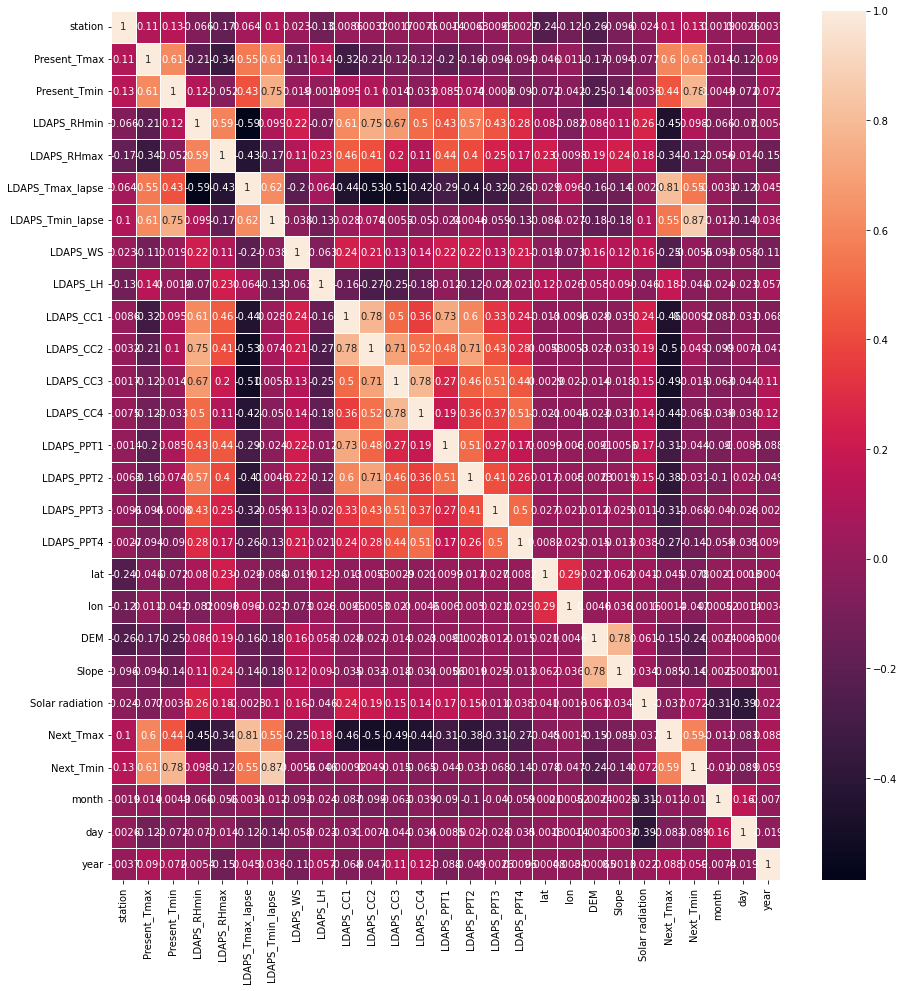

In [74]:
plt.figure(figsize=(15,16))
sns.heatmap(df.corr(),annot=True,linewidth=1)
plt.show()

(i) LDAPS_CC1 is Positively correlated with LDAPS_RHmin,LDAPS_RHmax

(ii) Present_Tmax,Present_Tmin in positively correlated with Tmax_lapse,Tmin_lapse

(iii) RHmin,RHmax is positively correlated eith CC1,CC2,CC3,CC4

(iv) Tmax_lapse is negatively correlated with CC1,CC2,CC3,CC4

(v) Next_Tmax is negatively correlated with CC1,CC2,CC3,CC4


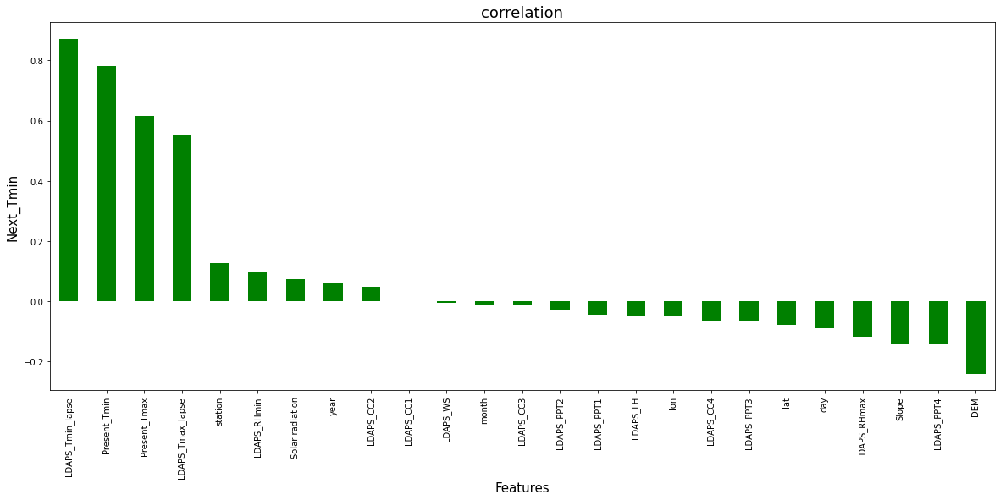

In [77]:
plt.figure(figsize = (20,8))
df.corr()['Next_Tmin'].sort_values(ascending = False).drop(['Next_Tmin','Next_Tmax']).plot(kind='bar',color = 'g')
plt.xlabel('Features',fontsize=15)
plt.ylabel('Next_Tmin',fontsize=15)
plt.title('correlation',fontsize = 18)
plt.show()

Tmin_lapse, Present Tmin,Present Tmax,Tmax_lapse are positive correlated with Next Tmin

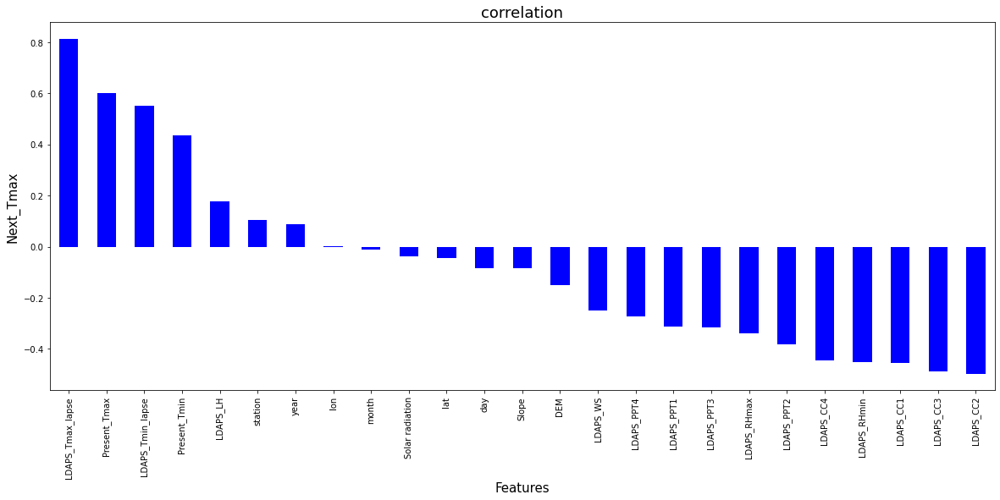

In [78]:
plt.figure(figsize = (20,8))
df.corr()['Next_Tmax'].sort_values(ascending = False).drop(['Next_Tmin','Next_Tmax']).plot(kind='bar',color = 'b')
plt.xlabel('Features',fontsize=15)
plt.ylabel('Next_Tmax',fontsize=15)
plt.title('correlation',fontsize = 18)
plt.show()

(i) Tmin_lapse, Present Tmin,Present Tmax,Tmax_lapse are positive correlated with Next Tmax

(ii) CC2,CC3,CC1,RHmin, CC4 etc are negatively correlated with Next_Tmax

# Scaling of Data

In [80]:
from sklearn.preprocessing import StandardScaler

X = df.drop(columns = ['Next_Tmax','Next_Tmin'])
y = df[['Next_Tmax','Next_Tmin']]
scaler = StandardScaler()
scaled_X = scaler.fit_transform(X)

# Checking of Multicollinearity 

In [81]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()

vif["Features"] = X.columns
vif['vif'] = [variance_inflation_factor(scaled_X,i) for i in range(scaled_X.shape[1])]

vif

,Features,vif
0,station,1.228978
1,Present_Tmax,2.814741
2,Present_Tmin,3.012880
3,LDAPS_RHmin,6.644989
4,LDAPS_RHmax,2.643551
5,LDAPS_Tmax_lapse,7.278440
6,LDAPS_Tmin_lapse,7.006773
7,LDAPS_WS,1.240387
8,LDAPS_LH,1.503731
9,LDAPS_CC1,5.088737


There is avlailibility of Multicollinearity

# PCA

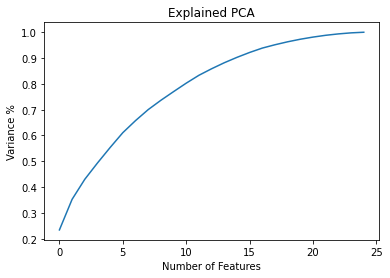

In [82]:
from sklearn.decomposition import PCA

pca = PCA()
principleComponents = pca.fit_transform(scaled_X)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Features')
plt.ylabel('Variance %')
plt.title('Explained PCA')
plt.show()


24 features required for best accuracy

# Selecting KBest features

In [85]:
from sklearn.feature_selection import SelectKBest, f_classif

bestfeat = SelectKBest(score_func = f_classif, k = 'all')
fit = bestfeat.fit(X,df['Next_Tmax'])
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

fit = bestfeat.fit(X,df['Next_Tmax'])
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
dfcolumns.head()
featureScores = pd.concat([dfcolumns,dfscores],axis = 1)
featureScores.columns = ['Feature', 'Score']
print(featureScores.nlargest(60,'Score'))

             Feature      Score
5   LDAPS_Tmax_lapse  88.719260
1       Present_Tmax  27.584870
6   LDAPS_Tmin_lapse  22.197539
10         LDAPS_CC2  16.583756
11         LDAPS_CC3  16.042471
9          LDAPS_CC1  13.941126
12         LDAPS_CC4  13.757949
3        LDAPS_RHmin  13.336766
2       Present_Tmin  13.107971
14        LDAPS_PPT2  10.051144
15        LDAPS_PPT3   8.995750
16        LDAPS_PPT4   7.748915
4        LDAPS_RHmax   6.907790
13        LDAPS_PPT1   6.650216
7           LDAPS_WS   4.393742
24              year   2.460311
19               DEM   2.440807
8           LDAPS_LH   2.321968
23               day   2.260443
0            station   1.567364
22             month   1.368932
20             Slope   1.303233
21   Solar radiation   1.236007
17               lat   0.999716
18               lon   0.914065


In [87]:
bestfeat = SelectKBest(score_func = f_classif, k = 'all')
fit = bestfeat.fit(X,df['Next_Tmin'])
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)

fit = bestfeat.fit(X,df['Next_Tmin'])
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
dfcolumns.head()
featureScores = pd.concat([dfcolumns,dfscores],axis = 1)
featureScores.columns = ['Feature', 'Score']
print(featureScores.nlargest(60,'Score'))

             Feature       Score
6   LDAPS_Tmin_lapse  166.845225
2       Present_Tmin   83.086459
1       Present_Tmax   34.132641
5   LDAPS_Tmax_lapse   24.261564
21   Solar radiation    4.265283
19               DEM    4.153217
3        LDAPS_RHmin    3.247314
4        LDAPS_RHmax    2.985272
16        LDAPS_PPT4    2.855363
12         LDAPS_CC4    2.338048
11         LDAPS_CC3    2.303504
0            station    2.203152
23               day    2.118023
10         LDAPS_CC2    2.021979
20             Slope    1.862188
9          LDAPS_CC1    1.814213
22             month    1.784448
24              year    1.773845
14        LDAPS_PPT2    1.607437
13        LDAPS_PPT1    1.578549
15        LDAPS_PPT3    1.517525
17               lat    1.452945
8           LDAPS_LH    1.354336
7           LDAPS_WS    1.209208
18               lon    0.927480


In [88]:
X.drop(columns=['LDAPS_Tmax_lapse','lon'],inplace=True,axis=1)

# Finding the best Random State

In [90]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.linear_model import Ridge
maxAcc = 0
maxRS=0
for i in range(1,100):
    x_train,x_test,y_train,y_test = train_test_split(X,y,test_size = .30, random_state = i)
    modRF =  Ridge()
    modRF.fit(x_train,y_train)
    pred = modRF.predict(x_test)
    acc  = r2_score(y_test,pred)
    if acc>maxAcc:
        maxAcc=acc
        maxRS=i
print(f"Best Accuracy is: {maxAcc} on random_state: {maxRS}")

Best Accuracy is: 0.7713658292471717 on random_state: 85


In [92]:
x_train,x_test,y_train,y_test = train_test_split(X,y,test_size = .30, random_state =72)



In [94]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import Ridge,Lasso
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor,AdaBoostRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor

from sklearn.metrics import r2_score,mean_squared_error
from sklearn.model_selection import ShuffleSplit,cross_val_score

RFR = RandomForestRegressor()
DTR = DecisionTreeRegressor()
KNN = KNeighborsRegressor()
L = Lasso()
R=Ridge()



In [96]:
models=[RFR,DTR,KNN,L,R]
for m in models:
    m.fit(x_train,y_train)
    pred=m.predict(x_test)
    r2=r2_score(y_test,pred)
    MSE=mean_squared_error(y_test,pred)
    RMSE=np.sqrt(mean_squared_error(y_test,pred))
    CVS=cross_val_score(m,X,y,cv=ShuffleSplit(5)).mean()
    print(m,"Results:")
    print("Accuracy:",r2)
    print("Cross Validation Score:",CVS)
    print("Mean Square Error:",MSE)
    print("Root Mean Sqaure Error:",RMSE)
    print("\n")

RandomForestRegressor() Results:
Accuracy: 0.9019108289123567
Cross Validation Score: 0.902759662460394
Mean Square Error: 0.7457399543429837
Root Mean Sqaure Error: 0.8635623627410957


DecisionTreeRegressor() Results:
Accuracy: 0.7709451815240908
Cross Validation Score: 0.7579615934456879
Mean Square Error: 1.7332939866369728
Root Mean Sqaure Error: 1.3165462341433258


KNeighborsRegressor() Results:
Accuracy: 0.47780000781796095
Cross Validation Score: 0.4879108177263629
Mean Square Error: 3.9411028953229392
Root Mean Sqaure Error: 1.985221120007275


Lasso() Results:
Accuracy: 0.6928653470280277
Cross Validation Score: 0.6786669150132575
Mean Square Error: 2.4678268021549763
Root Mean Sqaure Error: 1.5709318260685206


Ridge() Results:
Accuracy: 0.7691318450794987
Cross Validation Score: 0.7596414689188091
Mean Square Error: 1.8437364655409847
Root Mean Sqaure Error: 1.357842577599106




We cound the Random Forest Refressor is the best model to fit

# Hyper Parameter Tuning

In [ ]:
from sklearn.model_selection import GridSearchCV

parameter = {'n_estimators':[30,60],'max_depth': [10,20,40],'min_samples_leaf':[5,10,20],'min_samples_split':[5,10],'criterion':['mse','mae'],'max_features':["auto","sqrt","log2"]}

GridCV = GridSearchCV(RandomForestRegressor(),parameter,cv=3,n_jobs = -1,verbose = 1)
GridCV.fit(x_train,y_train)


In [ ]:
#printing the best params
GridCV.best_params_

In [105]:
fin_mod = RandomForestRegressor(n_estimators = 80,criterion = 'mse', max_depth= 40, max_features = 'auto',min_samples_leaf = 5, min_samples_split = 6)

In [106]:
#training the best model
fin_mod.fit(x_train,y_train)

RandomForestRegressor(max_depth=40, min_samples_leaf=5, min_samples_split=5,
                      n_estimators=60)

RandomForestRegressor(max_depth=40, min_samples_leaf=5, min_samples_split=5,
                      n_estimators=60)

In [107]:
rfpred = fin_mod.predict(x_test)
acc = r2_score(y_test,rfpred)
print(acc*100)

88.6859323521558


The model is performing at 88% accuracy which is acceptable

# Saving the model

In [108]:
import joblib
joblib.dump(fin_mod,'Temp_Prediction.obj')

['Temp_Prediction.obj']

Saved the model for future requirements